## Import packages

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import os,sys
os.environ['SCIPY_ARRAY_API'] = '1'
from ALLCools.clustering import ConsensusClustering
from ALLCools.plot import plot_dendrogram
from pym3c.adata import MultiAdata,plot_cluster
from pym3c.utils import read_markers
import anndata
import matplotlib.pylab as plt
%matplotlib inline
import seaborn as sns
import warnings
from IPython.display import display, Markdown, Latex
warnings.filterwarnings("ignore")
import matplotlib as mpl
mpl.style.use('default')
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.sans-serif'] = 'Arial'

## Parameters

In [2]:
param_yaml=None
level=1
rootdir="~/Projects/mouse_pfc/clustering/100kb"
metadata_path="~/Projects/mouse_pfc/metadata/metadata.filtered.tsv.gz"
adata_path = "*100kb*.h5ad"
exclude_adata = None
gene_adata_path="*Gene*.h5ad"
exclude_gene_adata=None
normalize_per_cell=True

obs_cols=["mCGFrac","mCHFrac",'log2PlateNormCov'] #'mCCCFrac','NoContacts','CisContactsRatio', 'TransContactsRatio','UniqueAlignFinalReads','MappedFragments'

# clustering parameters
run_clustering=None
n_neighbors = None
metric = "euclidean"
min_cluster_size = 50
leiden_repeats = 200
leiden_resolution2 = 0.5
consensus_rate = 0.5
train_frac = 0.5
train_max_n = 500
random_state = 0
max_iter = 50
n_jobs = 24
target_accuracy = 0.95
coord_base = "tsne" #tsne, umap
use_rep="X_scvi" # X_pca, X_scvi, X_pca_seurat, X_pca_harmony
cor_method = "pearson"
linkage_method = "average"

# marker genes
marker_path="~/Projects/BICAN/metadata/Markers.xlsx"
marker_sheet = 'BICAN'
marker_level = None
max_depth = None
palette_path=None

clustering_name_annot = "CellClass" #
parent_ct = None #'NonN'

final_mc_read_col="UniqueAlignFinalReads"

# gene mCG, mCH and promoter adata path prefix
species='human'
score_key='Gene-CHN'

In [3]:
# Parameters
level = 1
parent_ct = "Astrocyte"
obs_cols = ["Region", "donor", "tech", "mCGFrac", "mCHFrac", "leiden"]
rootdir = "/home/x-wding2/Projects/BG/clustering/ASC_clustering"
metadata_path = "/home/x-wding2/Projects/BG/clustering/100kb/L2/data/Astrocyte.metadata.txt"
mc_types = ["CGN"]
pca_downsample = False
use_lsi = False
normalize_per_cell = True
clip_norm_value = 10
max_value = None
with_mean = False
batch_col = ["Study", "tech", "donor"]
batch_correct_method = "harmony"
categorical_covariate_keys = None
n_layers = 1
std_cutoff = None
adata_path = ["~/Projects/BG/adata/BG.100kb-CGN.h5ad", "~/Projects/BG/adata/BG.100kb-CHN.h5ad", "~/Projects/BG/adata/BG.100kb-HiC.h5ad"]
exclude_adata = None
gene_adata_path = "/home/x-wding2/Projects/BG/adata/BG.gene-C*N.h5ad"
exclude_gene_adata = None
hic_embedding_dir = "/home/x-wding2/Projects/BG/HIC/100K_embedding/raw"
hic_cell_table_path = "/home/x-wding2/Projects/BG/HIC/impute/100K_cell_table.tsv"
cef_downsample = 500
top_n_enriched_features = 100
feature_type = "CEF"
alpha = 0.05
max_cell_prop = None
p_cutoff = 0.1
coord_base = "umap"
use_rep = "X_pca_harmony"
n_neighbors = None
metric = "euclidean"
min_cluster_size = 50
leiden_repeats = 200
leiden_resolution1 = 0.5
leiden_resolution2 = 1
consensus_rate = 0.5
train_frac = 0.5
train_max_n = 1000
random_state = 0
max_iter = 50
n_jobs = 8
target_accuracy = 0.9
cor_method = "pearson"
linkage_method = "average"
marker_path = "/home/x-wding2/Projects/BG/metadata/BG_markers.xlsx"
marker_sheet = "BG"
marker_level = None
max_depth = None
palette_path = "/home/x-wding2/Projects/BG/metadata/BG_color_palette.xlsx"
clustering_name_annot = "Group"
final_mc_read_col = "UniqueAlignFinalReads"
score_key = "BG.gene-CGN"
param_yaml = "/home/x-wding2/Projects/Github/pym3c/pym3c/notebooks/clustering/ASC_clustering.yaml"
kernel_name = "m3c"
species = "human"
run_subset = True


In [4]:
rootdir=os.path.abspath(os.path.expanduser(rootdir))
assert os.path.exists(rootdir)
clustering_name=f"L{level}"
cluster_col=clustering_name
if run_clustering is None:
    if not os.path.exists(os.path.join(rootdir,"obs_with_cluster_id.tsv")):
        run_clustering=True # run consensus clustering
    else:
        run_clustering=False #cluster_id is already existed in obs_with_cluster_id.tsv (skip consensus clustering)
        cluster_col='cluster_id'
if level == 1 or os.path.exists(os.path.join(rootdir,"obs_with_cluster_id.tsv")):
    run_annotation=True #added cell type scores using given marker genes
else:
    run_annotation=False # didn't calculate cell type score, only defined the cluster (iterative clustering)
if level > 1: #use metadata from previous round subtype.
    pre_clustering_name=f"L{level-1}"
    metadata_path=os.path.join(rootdir,pre_clustering_name,"data",f"{parent_ct}.metadata.txt")
print(metadata_path)
outdir=os.path.join(rootdir,clustering_name)
outdir=os.path.abspath(os.path.expanduser(outdir))
assert os.path.exists(outdir)
figdir=os.path.join(outdir,"figures")
datadir=os.path.join(outdir,"data")
if not os.path.exists(figdir):
    os.mkdir(figdir)
if not os.path.exists(datadir):
    os.mkdir(datadir)

if parent_ct is None:
    data_basename=os.path.join(datadir,f"{clustering_name}")
    fig_basename=os.path.join(figdir,f"{clustering_name}")
else:
    bname=f"{clustering_name}_{parent_ct}"
    data_basename=os.path.join(datadir,bname.replace(' ','_'))
    fig_basename=os.path.join(figdir,bname.replace(' ','_'))
input_adata_path=f"{data_basename}.concatenated_pcs.adata.h5ad"

if marker_level is None:
    marker_level=clustering_name_annot
if n_jobs is None or n_jobs==-1:
    n_jobs=os.cpu_count()
print(n_jobs)
basis=f"X_{coord_base}"

/home/x-wding2/Projects/BG/clustering/100kb/L2/data/Astrocyte.metadata.txt
8


## Read pre-cluster adata
The X of preclustered adata was emptied, X is fake. Need to read gene CG and CH adata and replace cluster_adata.X

In [5]:
print(input_adata_path)
adata = anndata.read_h5ad(input_adata_path) #adata.X is fake (all ones), do not use it.
adata

/home/x-wding2/Projects/BG/clustering/ASC_clustering/L1/data/L1_Astrocyte.concatenated_pcs.adata.h5ad


AnnData object with n_obs × n_vars = 8829 × 1
    obs: 'alpha', 'beta', 'prior_mean', 'Key', 'Study', 'tech', 'donor', 'leiden', 'InputReadPairs', 'InputReadPairsBP', 'TrimmedReadPairs', 'R1WithAdapters', 'R1QualTrimBP', 'R1TrimmedReadsBP', 'R2WithAdapters', 'R2QualTrimBP', 'R2TrimmedReadsBP', 'UniqueMappedReads', 'UniqueMappingRate', 'MultiMappedReads', 'MultiMappingRate', 'OverallMappingRate', 'R1UniqueMappedReads', 'R1MultiMappedReads', 'R1UniqueMappingRate', 'R1MultiMappingRate', 'R1OverallMappingRate', 'R2UniqueMappedReads', 'R2MultiMappedReads', 'R2UniqueMappingRate', 'R2MultiMappingRate', 'R2OverallMappingRate', 'UniqueAlignFinalReads', 'UniqueAlignDuplicatedReads', 'UniqueAlignPCRDuplicationRate', 'CisContacts', 'CisCutContacts', 'CisMultiContacts', 'CisCutMultiContacts', 'TransContacts', 'TransCutContacts', 'TransMultiContacts', 'TransCutMultiContacts', 'ChimericContacts', 'NoContacts', 'MappedFragments', 'DeduppedContacts', 'ContactsDeduplicationRate', 'TotalCisContacts', 'To

## Consensus Clustering

Computing nearest neighbor graph


Computing multiple clustering with different random seeds
Repeating leiden clustering 200 times


Found 14 - 17 clusters, mean 15.9, std 0.75
Summarizing multiple clustering results


8777 cells assigned to 15 raw clusters
52 cells are multi-leiden outliers

=== Start supervise model training and cluster merging ===

=== iteration 1 ===
15 non-outlier labels


Balanced accuracy on the training set: 0.961
Balanced accuracy on the hold-out set: 0.935
Stop iteration because current accuracy 0.935 > target accuracy 0.900.

=== Assign final labels ===


Assigned all the multi-leiden clustering outliers into clusters using the prediction model from final clustering version.


Final ten-fold CV Accuracy on all the cells: 0.939


16 15


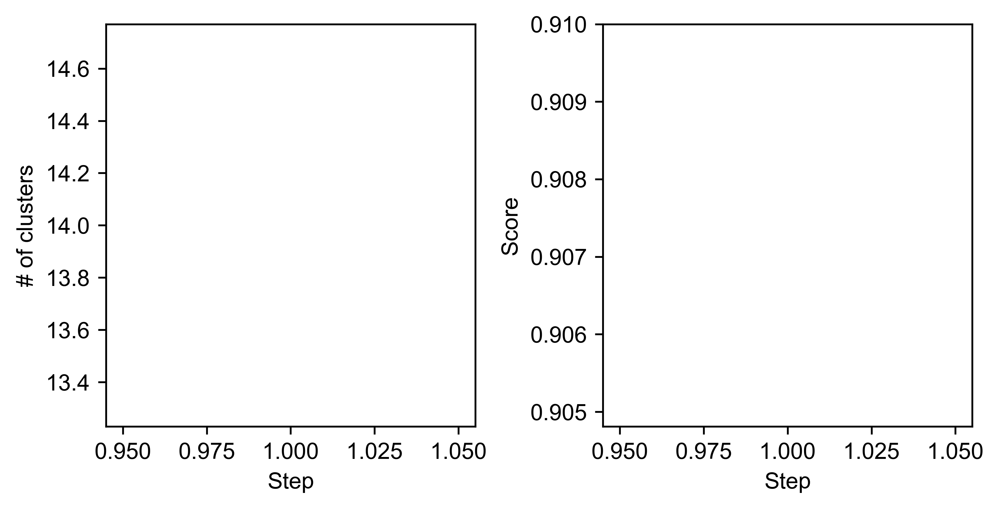

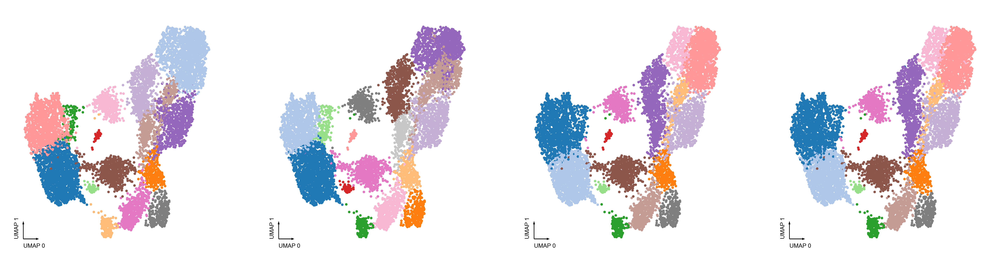

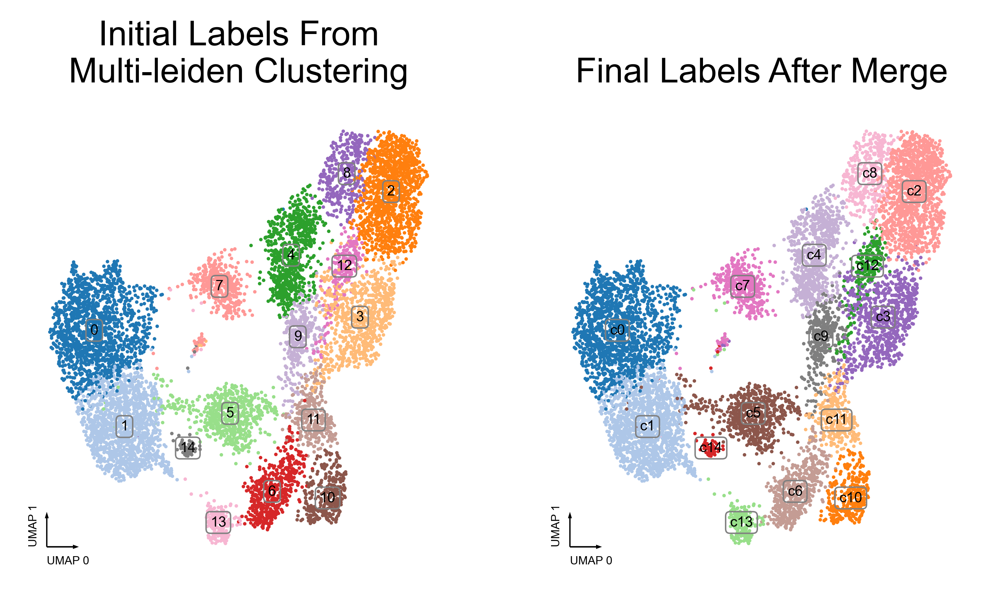

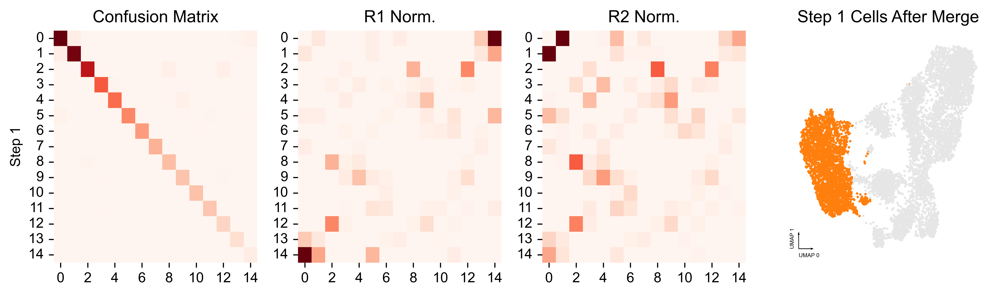

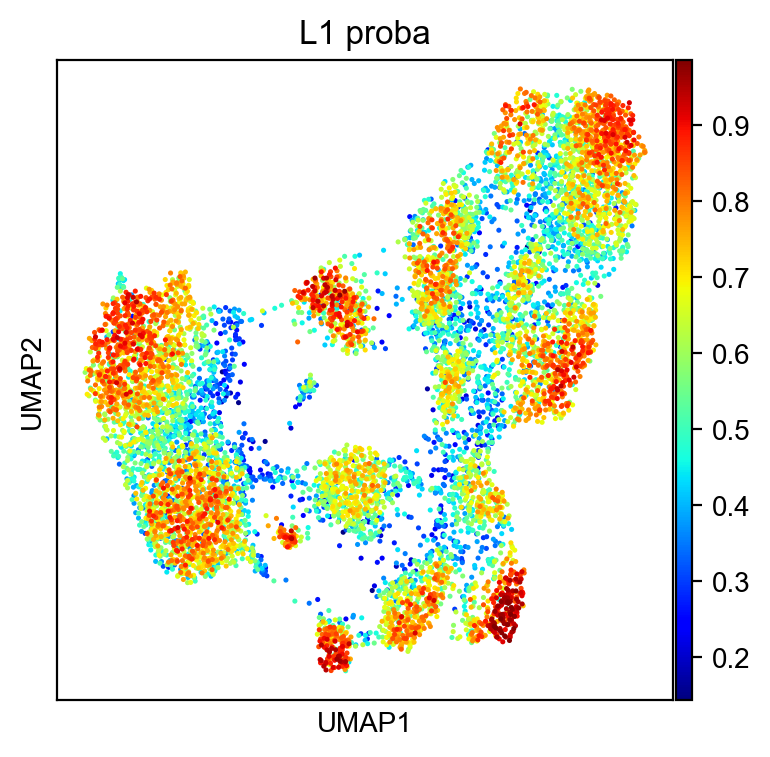

UWA7648_CX192021_CaB_1_P6-1-G5-F21               c5
UCI2424_CX17_GP_1_P7-1-N22-O17                   c7
UWA7648_CX192021_CaB_1_P5-1-P21-L7               c9
HBA_220303_H1930002_CX47_Pu_3C_1_P5-3-I24-I18    c7
UCI5224_CX171819BS02_MGM1_1_P17-1-D8-K21         c2
Name: L1, dtype: category
Categories (15, object): ['c0', 'c1', 'c2', 'c3', ..., 'c11', 'c12', 'c13', 'c14']
L1


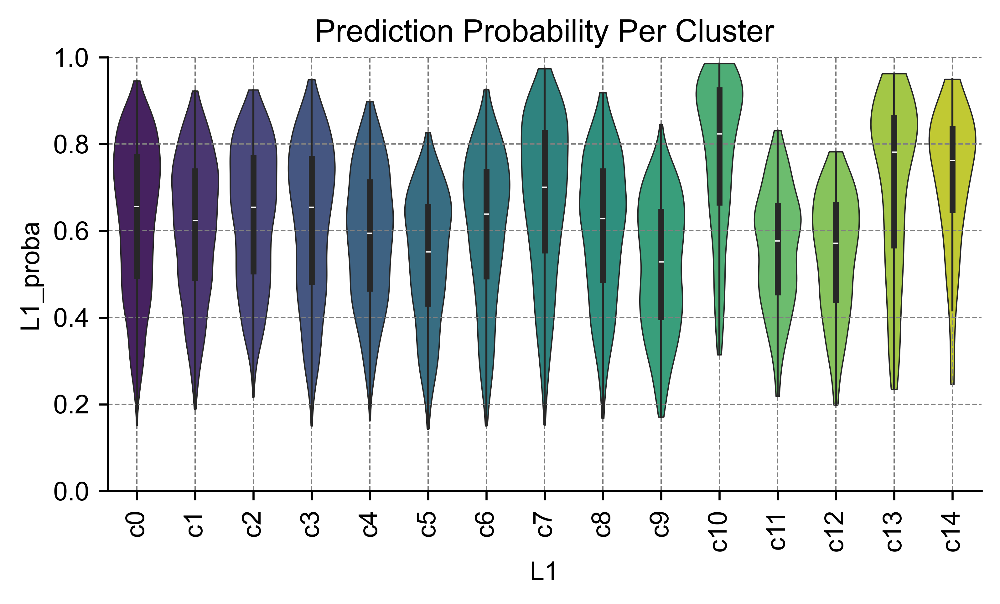

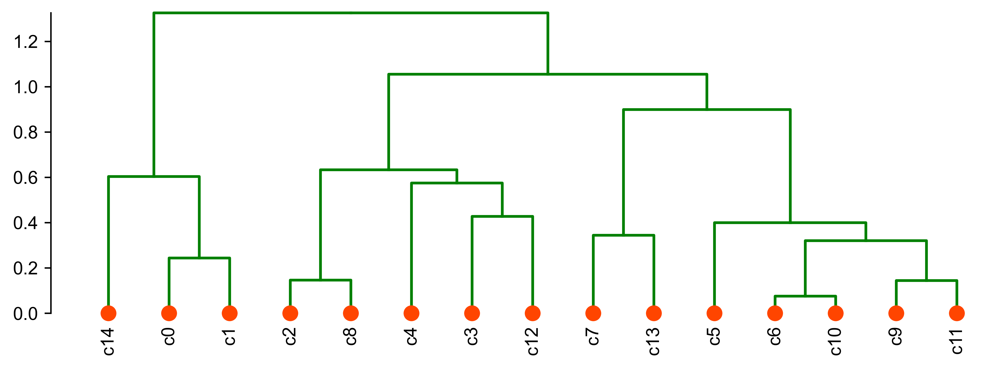

In [6]:
if run_clustering:
    if n_neighbors is None:
        n_neighbors = max(25, int(np.log2(adata.shape[0])*2))
    cc = ConsensusClustering(model=None,
                             n_neighbors=n_neighbors,
                             metric=metric,
                             min_cluster_size=min_cluster_size,
                             leiden_repeats=leiden_repeats,
                             leiden_resolution=leiden_resolution2,
                             consensus_rate=consensus_rate,
                             random_state=random_state,
                             train_frac=train_frac,
                             train_max_n=train_max_n,
                             max_iter=max_iter,
                             n_jobs=n_jobs,
                             target_accuracy=target_accuracy)

    cc.fit_predict(adata.obsm[use_rep]) #X_pca, X_scVI, X_pca_harmony or X_pca_seurat and so on.

    adata.obs[f'{coord_base}_0'] = adata.obsm[basis][:, 0]
    adata.obs[f'{coord_base}_1'] = adata.obsm[basis][:, 1]
    cc.plot_merge_process(plot_size=3)
    cc.plot_leiden_cases(coord_data=adata.obs,coord_base=coord_base) #Show some leiden runs with the biggest different as measured by ARI

    adata.obs[clustering_name] = cc.label #list of length n_cell
    print(len(set(cc._multi_leiden_clusters)), len(set(cc.label)))
    cc.plot_steps(coord_data=adata.obs, coord_base=coord_base) #Plot the supervised learning and merge steps

    adata.obs[clustering_name + '_proba'] = cc.label_proba

    with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (100)}):
        sc.pl.scatter(adata,#ax=ax,
                  basis=coord_base, #x='tsne_0',y='tsne_1',
                  color=clustering_name + '_proba',
                 color_map='jet') #legend_loc='on data', basis is one of 'pca', 'tsne', 'umap', 'diffmap', 'draw_graph_fr']

    fig, ax = plt.subplots(figsize=(6, 3), dpi=300)

    sns.violinplot(data=adata.obs,x=clustering_name,
                   y=clustering_name + '_proba',
                   scale='width',linewidth=0.5,cut=0,ax=ax,
                   palette=sns.color_palette("viridis", n_colors=adata.obs[clustering_name].nunique()))
    ax.set(ylim=(0, 1), title='Prediction Probability Per Cluster')
    ax.xaxis.set_tick_params(rotation=90)
    ax.grid(linewidth=0.5, color='gray', linestyle='--')
    sns.despine(ax=ax)

    if len(adata.obs[clustering_name].unique())>1:
        adata.obs[clustering_name] = adata.obs[clustering_name].astype('category')
        sc.tl.dendrogram(adata, groupby=clustering_name,
                         n_pcs=adata.obsm[use_rep].shape[1],use_rep=use_rep,
                        cor_method=cor_method,linkage_method=linkage_method
                        )

        fig, ax = plt.subplots(figsize=(9, 3), dpi=300)
        _ = plot_dendrogram(dendro=adata.uns[f'dendrogram_{clustering_name}']['dendrogram_info'],
                            linkage_df=pd.DataFrame(adata.uns[f'dendrogram_{clustering_name}']['linkage']),
                            ax=ax,edge_color='green',marker_color='orangered',node_size_norm=True,
                            plot_non_singleton=False,)

    cc.save(f'{data_basename}.cc.model.lib')
    # dendro.save(f'{clustering_name}.Dendrogram.lib')
    # else:
    #     adata.obs[clustering_name]=adata.obs['leiden'].apply(lambda x:f"c{x}")
    print(adata.obs[clustering_name].head())

print(clustering_name)

In [7]:
# uid={plate}-{multiplex_group}-{primer_name}
# cell_id = uid-index_name = {plate}-{multiplex_group}-{primer_name}-{index_name}
# UniqueAlignFinalReads equal to FinalmCReads
if not final_mc_read_col is None:
    if 'log2PlateNormCov' not in adata.obs.columns:
        adata.obs['Plate']=adata.obs.index.to_series().apply(lambda x:x.split('-')[0])
        plate_avg_read_dict=adata.obs.groupby('Plate')[final_mc_read_col].mean().to_dict()
        # plate normalized cell coverage (PNCC), refer to 2023 hanqing's paper
        adata.obs['PlateNormCov']=adata.obs.apply(lambda x:x[final_mc_read_col] / plate_avg_read_dict[x['Plate']],axis=1)
        adata.obs['log2PlateNormCov'] = np.log2(adata.obs['PlateNormCov'])

    # adata.obs['is_doublet']=adata.obs.log2PlateNormCov.apply(lambda x:True if abs(x) > 0.8 else False)
    adata.obs['is_doublet']=adata.obs.PlateNormCov.apply(lambda x:1 if x > 1.2 or x < 0.8 else 0)
    print(adata.obs['is_doublet'].value_counts())

is_doublet
0    5272
1    3557
Name: count, dtype: int64


In [8]:
if not final_mc_read_col is None:
    doublet_percent=(adata.obs.groupby(cluster_col)['is_doublet'].sum() / adata.obs[cluster_col].value_counts()) * 100
    doublet_percent.sort_values(ascending=False,inplace=True)
    print(doublet_percent)

L1
c11    54.849498
c12    52.401747
c5     45.498392
c9     43.806647
c7     42.720764
c14    42.253521
c2     41.609589
c8     41.470588
c6     41.104294
c10    38.679245
c1     37.804878
c3     37.740693
c13    37.433155
c4     36.754508
c0     36.183311
dtype: float64


## Visualization

<Figure size 400x400 with 0 Axes>

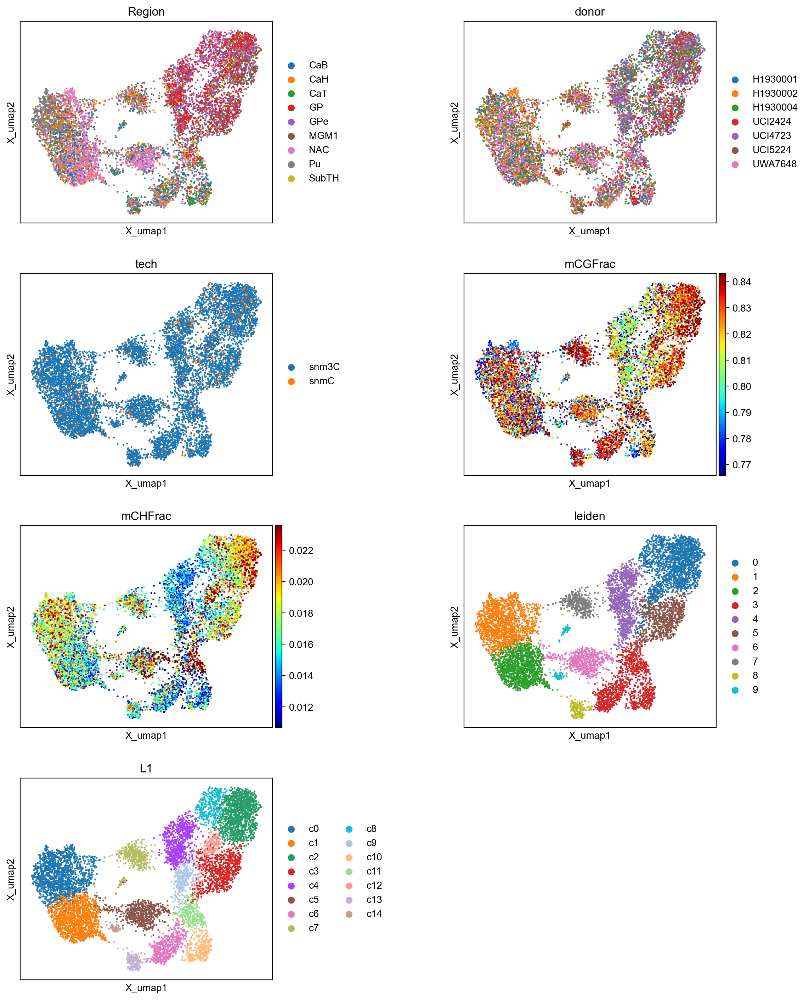

In [10]:
use_cols=obs_cols+[cluster_col] if adata.obs[cluster_col].nunique() < 50 else obs_cols
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (100)}):
    plt.figure()
    sc.pl.embedding(adata,basis=basis,color=use_cols,cmap='jet',
           ncols=2,wspace=0.6,show=False,vmin='p5',vmax='p95') #Non-Neuron cells have low global mCH fraction.
    plt.savefig(f"{fig_basename}.summary.{coord_base}.pdf",bbox_inches='tight',dpi=300)
    plt.show()

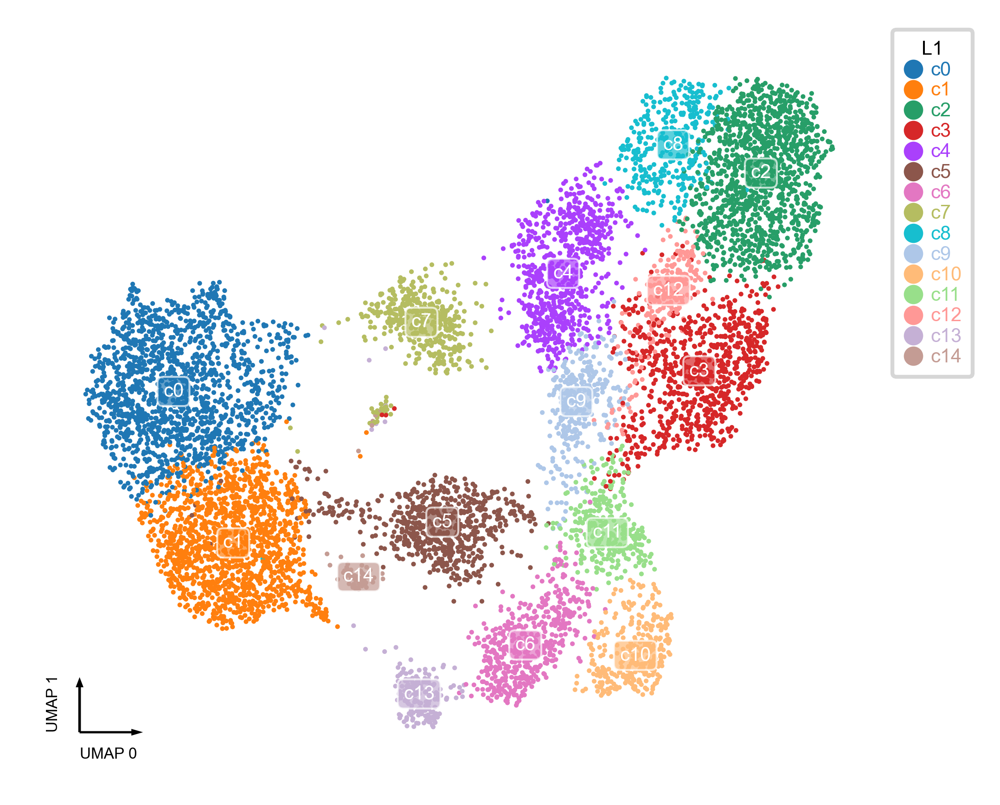

In [11]:
if cluster_col in use_cols:
    colors={cluster:color for cluster,color in zip(adata.obs[cluster_col].cat.categories.tolist(),adata.uns[f'{cluster_col}_colors'])}
    plot_cluster(adata_path=adata,coord_base=coord_base,
                 cluster_col=cluster_col,
                 coding=False,palette_path=colors,
                 output=f"{fig_basename}.annotated.{coord_base}.{cluster_col}.pdf")

In [12]:
adata.strings_to_categoricals()
adata.write_h5ad(f'{data_basename}.ConsensusClustering.adata.h5ad')
adata.obs.to_csv(f"{data_basename}.obs.tsv",sep='\t')
adata.obs

,alpha,beta,prior_mean,Key,Study,tech,donor,leiden,InputReadPairs,InputReadPairsBP,...,Astrocyte_score,Endo_score,VLMC_score,VLMC-Pia_score,Pericyte_score,SMC_score,Subclass_HMBA,L2,L3,Subclass
UWA7648_CX192021_CaB_1_P6-1-G5-F21,5.301407,0.973150,0.844905,SALK037.100kb-CGN,BICAN,snm3C,UWA7648,6,1556382,473140128,...,-0.249120,-0.109944,0.057826,0.055323,-0.015801,-0.000901,Astrocyte,c8+c1,c8+c1+c0,Astrocyte
UCI2424_CX17_GP_1_P7-1-N22-O17,5.118814,0.914017,0.848493,SALK296_SALK298.100kb-CGN,BICAN,snm3C,UCI2424,7,2022382,614804128,...,-0.246590,-0.047414,0.110581,0.020956,-0.036946,-0.037992,Astrocyte,c8+c6,c8+c6+c0,Astrocyte
UWA7648_CX192021_CaB_1_P5-1-P21-L7,5.597593,1.020547,0.845796,SALK037.100kb-CGN,BICAN,snm3C,UWA7648,4,1335258,405918432,...,-0.201613,0.024492,-0.024393,-0.027963,-0.066382,0.034216,Astrocyte,c8+c3,c8+c3+c2,Astrocyte
HBA_220303_H1930002_CX47_Pu_3C_1_P5-3-I24-I18,6.119994,1.196907,0.836419,HBA_snm3C_Pu.100kb-CGN,HBA,snm3C,H1930002,7,2147221,625409290,...,-0.213680,-0.038316,-0.041760,0.112303,0.030373,-0.063421,Astrocyte,c8+c6,c8+c6+c0,Astrocyte
UCI5224_CX171819BS02_MGM1_1_P17-1-D8-K21,7.876686,1.385771,0.850388,SALK227_SALK228.100kb-CGN,BICAN,snm3C,UCI5224,0,3072907,934163728,...,-0.332975,-0.019270,-0.060750,0.083779,0.032207,0.005301,SMC,c8+c0,c8+c0+c6,Astrocyte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
UWA7648_CX1819_NAC_1_P2-1-E5-D10,7.341643,1.232535,0.856250,SALK045.100kb-CGN,BICAN,snm3C,UWA7648,6,2712782,824685728,...,-0.326907,0.012448,0.045012,0.072824,-0.009524,-0.023873,Astrocyte,c8+c4,c8+c4+c4,Astrocyte
UWA7648_CX1819_NAC_1_P9-1-M14-K20,7.100829,1.053067,0.870851,SALK045.100kb-CGN,BICAN,snm3C,UWA7648,1,2226517,676861168,...,-0.331812,-0.041186,-0.079432,0.071096,-0.071392,-0.021420,Astrocyte,c8+c4,c8+c4+c5,Astrocyte
UCI4723_CX17_GP_1_P3-1-F3-B7,6.385741,1.328900,0.827743,SALK290_SALK297.100kb-CGN,BICAN,snm3C,UCI4723,4,2184068,663956672,...,-0.254864,-0.164015,-0.179665,-0.003279,0.060640,-0.021344,Astrocyte,c8+c2,c8+c2+c1,Astrocyte
UCI4723_CX1819BS01_MGM1_1_P1-1-K15-F7,5.307245,0.786231,0.870972,SALK134_SALK136.100kb-CGN,BICAN,snm3C,UCI4723,0,1875471,570143184,...,-0.235476,-0.019890,0.040562,-0.047209,-0.062389,0.047477,SMC,c8+c0,c8+c0+c0,Astrocyte


## Read markers

In [6]:
if run_annotation:
    df_marker=read_markers(
        marker_path,marker_sheet,
        max_depth,marker_level,parent_ct,
        species,marker_cols = ['RNA_markers', 'Methylation_markers']
    )
else:
    df_marker=None
df_marker

BG


,Level,Parent,CellType,CellTypeName,Depth,RNA_markers,Methylation_markers,SelectedMarkers,Note,Markers
56,Group,Astrocyte,GM STR,NaN,3,"[ADGRV1, GRM3, SLC1A2, NRXN1, PREX2, TMEM132C,...",[],['SLC1A2'],NaN,"[ADGRV1, GRM3, SLC1A2, NRXN1, PREX2, TMEM132C,..."
57,Group,Astrocyte,WM,NaN,3,"[DCLK1, AC012405.1, ADAMTSL3, PLEKHA5, LINC006...",[],['GFAP'],NaN,"[DCLK1, AC012405.1, ADAMTSL3, PLEKHA5, LINC006..."
58,Group,Astrocyte,GM exSTRd,exclude striotome,3,"[TRPM3, RGS6, SLC6A11, KCND2, DPP6, TNC, RYR3,...",[],NaN,NaN,"[TRPM3, RGS6, SLC6A11, KCND2, DPP6, TNC, RYR3,..."
59,Group,Astrocyte,Astrocyte,NaN,3,"[ADGRV1, TMEM132C, WIF1, GRM3, AKAP12, GNA14, ...",[],NaN,NaN,"[ADGRV1, TMEM132C, WIF1, GRM3, AKAP12, GNA14, ..."
60,Group,Astrocyte,ImAstro,NaN,3,"[RGS18, CD69, HLA-DQA1, CEACAM21, NCF1, VSIG4,...",[],NaN,NaN,"[RGS18, CD69, HLA-DQA1, CEACAM21, NCF1, VSIG4,..."


## Add other gene adatas (multi adata)

In [14]:
# adata=anndata.read_h5ad(f'{data_basename}.ConsensusClustering.adata.h5ad')
# adata

### Calculate cell type score using marker genes

In [7]:
if run_annotation:
    madata=MultiAdata(
        adata_path=gene_adata_path,exclude=exclude_gene_adata,
        metadata_path=metadata_path)
    print(score_key)
    cell_types=df_marker.CellType.dropna().unique().tolist()

BG.gene-CHN adata.shape: (265428, 37979) PCA shape: (265428, 64)
BG.gene-CGN adata.shape: (265428, 37979) PCA shape: (265428, 49)
n_obs: 8829
BG.gene-CGN


BG.gene-CGN adata.shape: (265428, 37979) PCA shape: (265428, 49)


n_obs: 8829
BG.gene-CGN


In [16]:
if run_annotation:
    cell_types=df_marker.CellType.dropna().unique().tolist()
    for celltype in cell_types:
        print(celltype)
        markers=df_marker.loc[df_marker.CellType==celltype].Markers.tolist()[0]
        if len(markers)==0:
            continue
        if f"{celltype}_score" in adata.obs.columns:
            continue
        try:
            df=madata.score_genes(markers,keys=score_key,normalize_per_cell=True)
        except:
            continue
        # for col in df.columns.tolist():
        #     adata.obs[f"{celltype}.{col}"]=df.loc[adata.obs_names,col].tolist()
        adata.obs[f"{celltype}_score"]=df.loc[adata.obs_names,score_key].tolist()
# print(adata.obs.head())

GM STR


Normalizing cell level fraction by alpha and beta (prior_mean)


WM


Normalizing cell level fraction by alpha and beta (prior_mean)
GM exSTRd


Normalizing cell level fraction by alpha and beta (prior_mean)
Astrocyte
ImAstro


Normalizing cell level fraction by alpha and beta (prior_mean)


tsne


<Figure size 640x480 with 0 Axes>

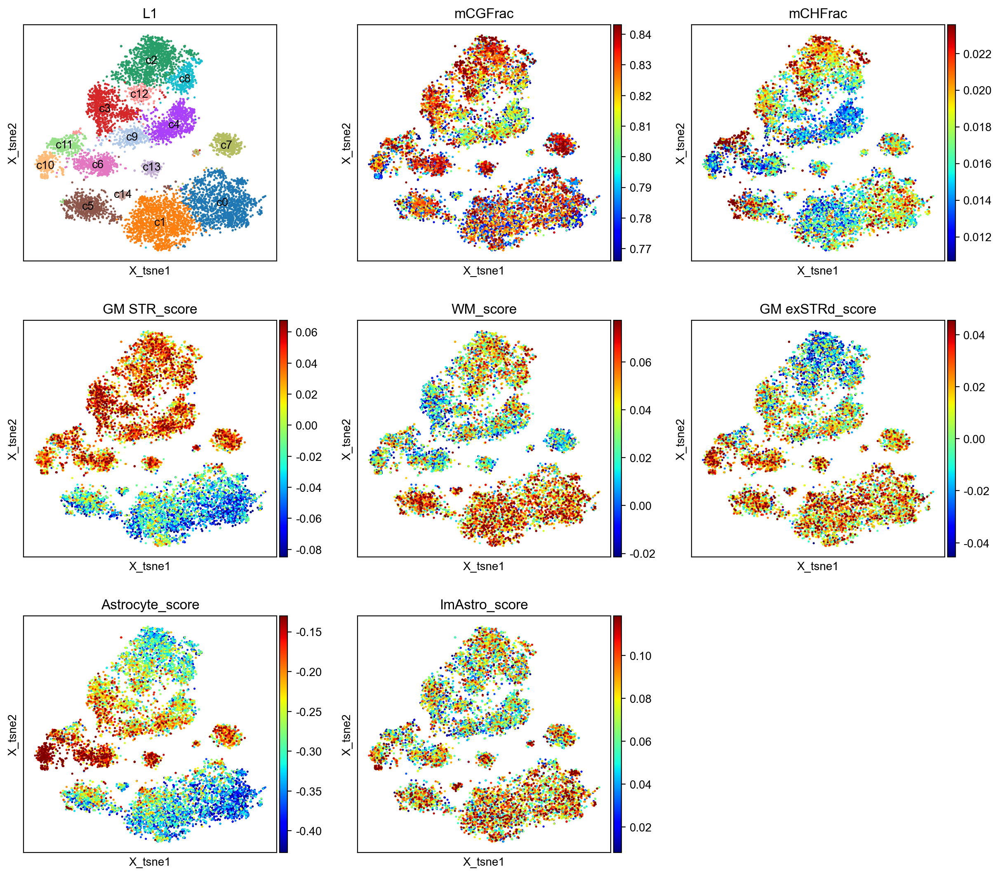

umap


<Figure size 640x480 with 0 Axes>

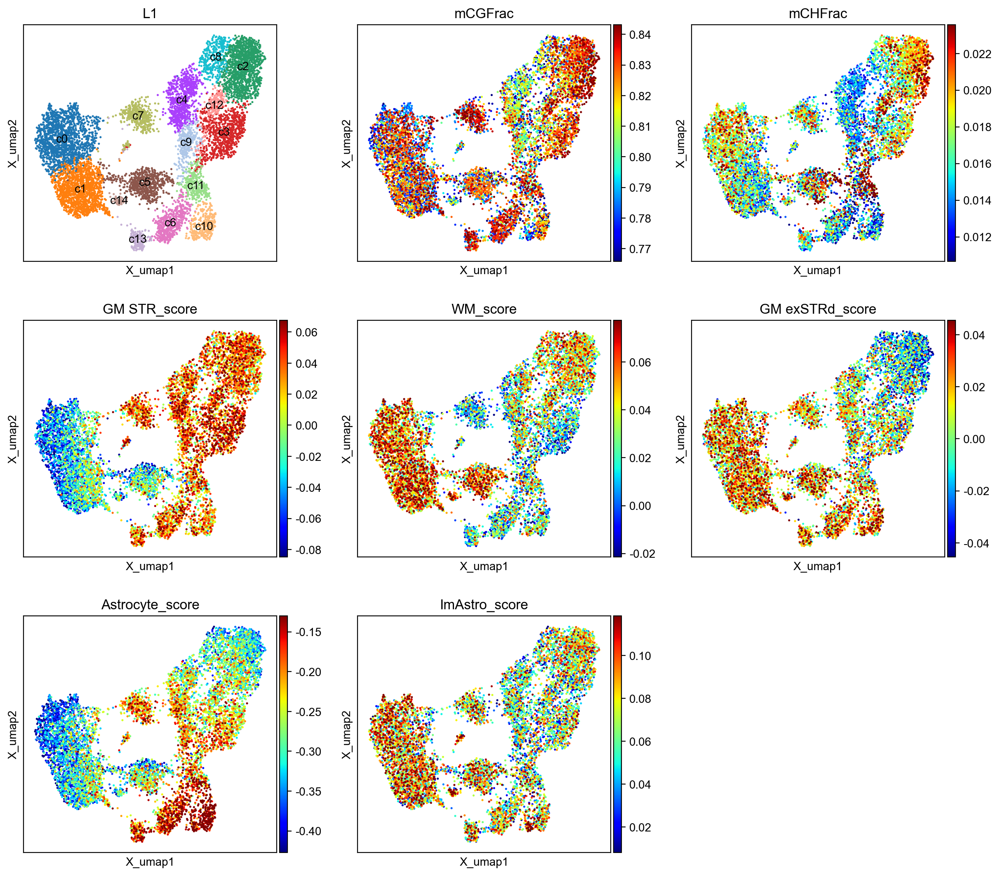

/home/x-wding2/Projects/BG/clustering/ASC_clustering/L1/data/L1_Astrocyte.ConsensusClustering.WithScores.adata.h5ad


In [17]:
if run_annotation:
    score_cols = [f"{celltype}_score" for celltype in cell_types]
    for embedding in ['tsne','umap']:
        if f"X_{embedding}" not in adata.obsm:
            continue
        print(embedding)
        plt.figure()
        with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (100)}):
            sc.pl.embedding(
                    adata,basis=f"X_{embedding}",
                    color=[cluster_col,'mCGFrac','mCHFrac']+score_cols, #gene_symbols='gene_name',
                   wspace=0.2,ncols=3,show=False,
                   legend_loc='on data',use_raw=False,
                   vmin='p5',vmax='p95',
                   cmap='jet' #vcenter='p50'
                      )
        plt.savefig(f"{fig_basename}.auto_ann.{embedding}.pdf",bbox_inches='tight',dpi=300)
        plt.show()

    output_adata=f'{data_basename}.ConsensusClustering.WithScores.adata.h5ad'
    # save adata
    adata.strings_to_categoricals()
    adata.write_h5ad(output_adata)
    adata.obs.to_csv(f"{data_basename}.obs.tsv",sep='\t')
    print(output_adata)

In [8]:
adata=anndata.read_h5ad(f'{data_basename}.ConsensusClustering.WithScores.adata.h5ad')
adata

AnnData object with n_obs × n_vars = 8829 × 1
    obs: 'alpha', 'beta', 'prior_mean', 'Key', 'Study', 'tech', 'donor', 'leiden', 'InputReadPairs', 'InputReadPairsBP', 'TrimmedReadPairs', 'R1WithAdapters', 'R1QualTrimBP', 'R1TrimmedReadsBP', 'R2WithAdapters', 'R2QualTrimBP', 'R2TrimmedReadsBP', 'UniqueMappedReads', 'UniqueMappingRate', 'MultiMappedReads', 'MultiMappingRate', 'OverallMappingRate', 'R1UniqueMappedReads', 'R1MultiMappedReads', 'R1UniqueMappingRate', 'R1MultiMappingRate', 'R1OverallMappingRate', 'R2UniqueMappedReads', 'R2MultiMappedReads', 'R2UniqueMappingRate', 'R2MultiMappingRate', 'R2OverallMappingRate', 'UniqueAlignFinalReads', 'UniqueAlignDuplicatedReads', 'UniqueAlignPCRDuplicationRate', 'CisContacts', 'CisCutContacts', 'CisMultiContacts', 'CisCutMultiContacts', 'TransContacts', 'TransCutContacts', 'TransMultiContacts', 'TransCutMultiContacts', 'ChimericContacts', 'NoContacts', 'MappedFragments', 'DeduppedContacts', 'ContactsDeduplicationRate', 'TotalCisContacts', 'To

## Plot markers

In [19]:
# df_marker1=df_marker.loc[:,['Level','CellType','Markers']]
# ct_generator=iter(df_marker1.CellType.tolist())
# df_marker1

In [20]:
# try:
#     celltype=next(ct_generator)
#     print(celltype)
# except StopIteration:
#     print("finished")

Normalizing cell level fraction by alpha and beta (prior_mean)
['SLC1A2', 'SPARCL1', 'GRM3', 'SLC6A11', 'SPARC', 'GABBR2']


<Figure size 640x480 with 0 Axes>

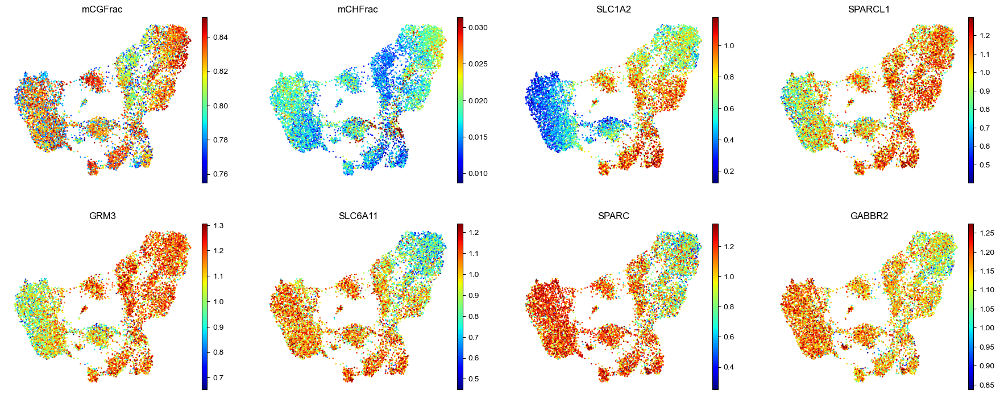

In [17]:
markers=['SLC1A2', 'SPARCL1', 'GRM3', 'SLC6A11', 'SPARC', 'GABBR2']
color=['mCGFrac','mCHFrac'] #if level == 1 else [cluster_col,'L1','mCHFrac']
use_adata=madata.get_adata(score_key,markers,adata,normalize_per_cell=True)
cols=adata.obs.columns.tolist()
for col in cols:
    use_adata.obs[col]=use_adata.obs_names.map(adata.obs[col].to_dict())
keep_markers=[]
for m in markers:
    if m in use_adata.var_names:
        keep_markers.append(m)
    else:
        print(m)
print(keep_markers)
plt.figure()
with plt.rc_context({"figure.figsize": (4.5, 4), "figure.dpi": (100)}):
    sc.pl.embedding(use_adata,basis=basis,color=color+keep_markers, #gene_symbols='gene_name',
               wspace=0.2,ncols=4,show=False,frameon=False,
               legend_loc='on data',
               vmin='p1',vmax='p99',
               cmap='jet' #vcenter='p50'
              )
plt.savefig(f"{fig_basename}.{score_key}.markers.{coord_base}.pdf",bbox_inches='tight',dpi=300)
plt.show()

Normalizing cell level fraction by alpha and beta (prior_mean)
['GRM3', 'WIF1', 'TMEM132C', 'ADAMTS17', 'OAF', 'CACNA1A', 'EPHA4', 'LHX2', 'CSPG5', 'SLIT1', 'FOXG1', 'EMX2', 'SLC6A11', 'ADCY1', 'SPARC', 'CDH23', 'PTPRJ', 'DCLK1', 'ADAMTSL3', 'COL21A1', 'SLC38A1', 'CCDC85A', 'KCNJ3', 'GALNT15', 'CPAMD8', 'STXBP5L', 'MAN1C1', 'ANGPT1', 'SLCO3A1', 'SMAD9', 'CREB5']


<Figure size 640x480 with 0 Axes>

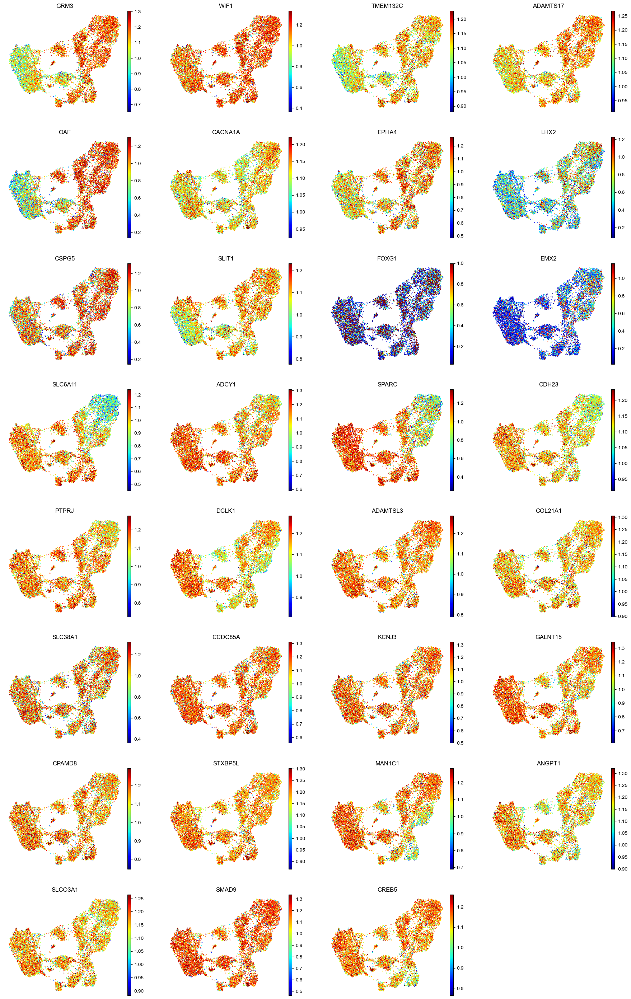

In [18]:
markers =['GRM3', 'WIF1', 'TMEM132C', 'ADAMTS17', 'OAF',  'CACNA1A', 'EPHA4', 'LHX2', 'CSPG5', 'SLIT1', 'FOXG1', 'EMX2', 
          'SLC6A11', 'ADCY1', 'SPARC', 'CDH23', 'PTPRJ', # GM exSTR
          'DCLK1', 'ADAMTSL3', 'COL21A1', 'SLC38A1', 'CCDC85A', 'KCNJ3', 'GALNT15', 'CPAMD8', 'STXBP5L', 'MAN1C1', 'ANGPT1', 'SLCO3A1', 'SMAD9', 'CREB5', # WM 
          ]
color=[] #if level == 1 else [cluster_col,'L1','mCHFrac']
use_adata=madata.get_adata(score_key,markers,adata,normalize_per_cell=True)
cols=adata.obs.columns.tolist()
for col in cols:
    use_adata.obs[col]=use_adata.obs_names.map(adata.obs[col].to_dict())
keep_markers=[]
for m in markers:
    if m in use_adata.var_names:
        keep_markers.append(m)
    else:
        print(m)
print(keep_markers)
plt.figure()
with plt.rc_context({"figure.figsize": (4.5, 4), "figure.dpi": (100)}):
    sc.pl.embedding(use_adata,basis=basis,color=color+keep_markers, #gene_symbols='gene_name',
               wspace=0.2,ncols=4,show=False,frameon=False,
               legend_loc='on data',
               vmin='p1',vmax='p99',
               cmap='jet' #vcenter='p50'
              )
plt.savefig(f"{fig_basename}.{score_key}.markers.{coord_base}-2.pdf",bbox_inches='tight',dpi=300)
plt.show()

Normalizing cell level fraction by alpha and beta (prior_mean)
['SLC1A2', 'NRXN1', 'GPC5', 'GLUL', 'PTCH1', 'TNC', 'GFAP', 'DPP6', 'TSHZ2', 'RGS6', 'DPP10']


<Figure size 640x480 with 0 Axes>

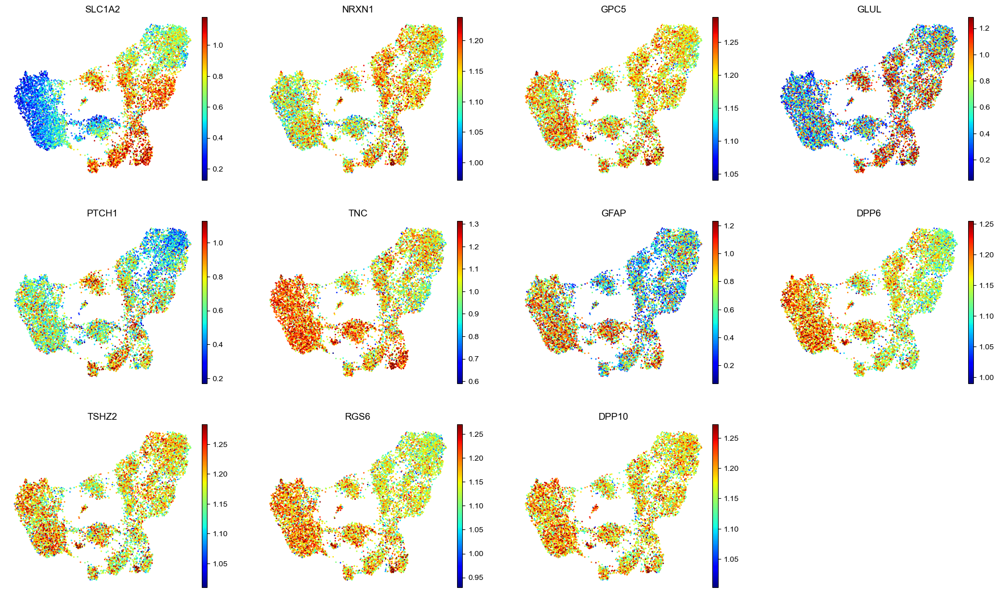

In [19]:
markers=['SLC1A2', 'NRXN1', 'GPC5', 'GLUL', 'PTCH1', # GM
                 'TNC', 'GFAP', 'DPP6', 'TSHZ2', 'RGS6', # GM exSTR + WM
                 'DPP10'] # GM STR + WM
color=[] #if level == 1 else [cluster_col,'L1','mCHFrac']
use_adata=madata.get_adata(score_key,markers,adata,normalize_per_cell=True)
cols=adata.obs.columns.tolist()
for col in cols:
    use_adata.obs[col]=use_adata.obs_names.map(adata.obs[col].to_dict())
keep_markers=[]
for m in markers:
    if m in use_adata.var_names:
        keep_markers.append(m)
    else:
        print(m)
print(keep_markers)
plt.figure()
with plt.rc_context({"figure.figsize": (4.5, 4), "figure.dpi": (100)}):
    sc.pl.embedding(use_adata,basis=basis,color=color+keep_markers, #gene_symbols='gene_name',
               wspace=0.2,ncols=4,show=False,frameon=False,
               legend_loc='on data',
               vmin='p1',vmax='p99',
               cmap='jet' #vcenter='p50'
              )
plt.savefig(f"{fig_basename}.{score_key}.markers.{coord_base}-3.pdf",bbox_inches='tight',dpi=300)
plt.show()

Normalizing cell level fraction by alpha and beta (prior_mean)
['DRD1', 'DRD2', 'DRD3', 'DRD4', 'DRD5']


<Figure size 640x480 with 0 Axes>

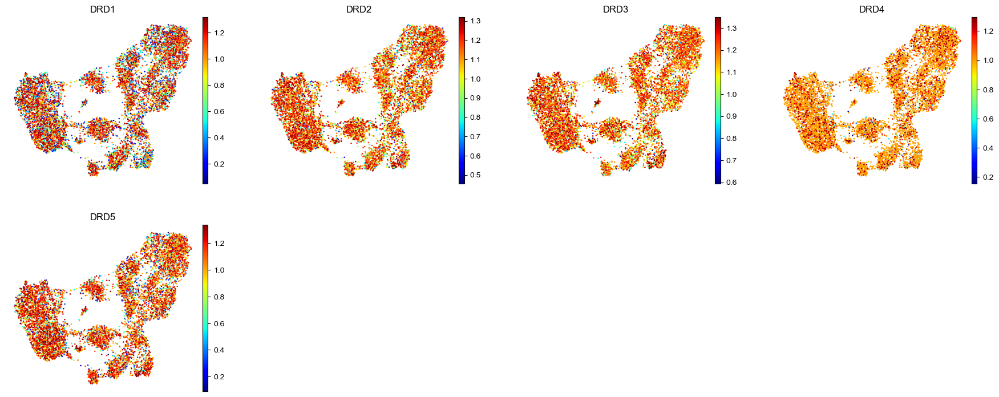

In [9]:
markers=['DRD1', 'DRD2', 'DRD3', 'DRD4', 'DRD5']
color=[] #if level == 1 else [cluster_col,'L1','mCHFrac']
use_adata=madata.get_adata(score_key,markers,adata,normalize_per_cell=True)
cols=adata.obs.columns.tolist()
for col in cols:
    use_adata.obs[col]=use_adata.obs_names.map(adata.obs[col].to_dict())
keep_markers=[]
for m in markers:
    if m in use_adata.var_names:
        keep_markers.append(m)
    else:
        print(m)
print(keep_markers)
plt.figure()
with plt.rc_context({"figure.figsize": (4.5, 4), "figure.dpi": (100)}):
    sc.pl.embedding(use_adata,basis=basis,color=color+keep_markers, #gene_symbols='gene_name',
               wspace=0.2,ncols=4,show=False,frameon=False,
               legend_loc='on data',
               vmin='p1',vmax='p99',
               cmap='jet' #vcenter='p50'
              )
plt.savefig(f"{fig_basename}.{score_key}.markers.{coord_base}-4.pdf",bbox_inches='tight',dpi=300)
plt.show()

Normalizing cell level fraction by alpha and beta (prior_mean)
['JUN', 'JUNB', 'JUND', 'FOS', 'FOSB']


<Figure size 640x480 with 0 Axes>

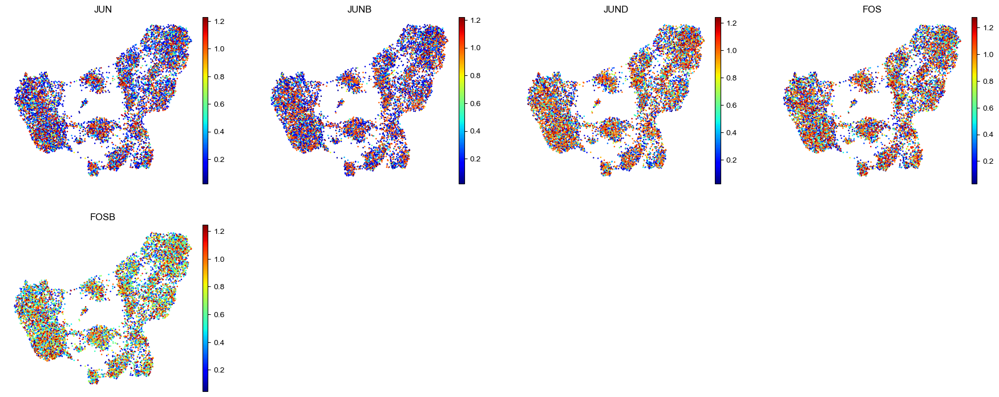

In [8]:
markers=['JUN', 'JUNB', 'JUND', 'FOS', 'FOSB']
color=[] #if level == 1 else [cluster_col,'L1','mCHFrac']
key='BG.gene-CGN'
use_adata=madata.get_adata(key,markers,adata,normalize_per_cell=True)
cols=adata.obs.columns.tolist()
for col in cols:
    use_adata.obs[col]=use_adata.obs_names.map(adata.obs[col].to_dict())
keep_markers=[]
for m in markers:
    if m in use_adata.var_names:
        keep_markers.append(m)
    else:
        print(m)
print(keep_markers)
plt.figure()
with plt.rc_context({"figure.figsize": (4.5, 4), "figure.dpi": (100)}):
    sc.pl.embedding(use_adata,basis=basis,color=color+keep_markers, #gene_symbols='gene_name',
               wspace=0.2,ncols=4,show=False,frameon=False,
               legend_loc='on data',
               vmin='p1',vmax='p99',
               cmap='jet' #vcenter='p50'
              )
plt.savefig(f"{fig_basename}.{key}.markers.{coord_base}-5.pdf",bbox_inches='tight',dpi=300)
plt.show()